In [1]:
import os
import torch
from PIL import Image
import numpy as np
from torch.utils.data import Dataset
from pycocotools.coco import COCO
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
class CocoDataset(Dataset):
    """
    Dataset class for COCO segmentation dataset.
    
    This class handles loading and preprocessing of COCO images and their corresponding
    segmentation masks.
    """
    
    def __init__(self, root_dir: str, annotation_file: str, transform=None):
        """
        Initialize the COCO dataset.
        
        Args:
            root_dir (str): Root directory containing the images
            annotation_file (str): Path to COCO annotation JSON file
            transform: Optional transform to be applied to images and masks
        """
        self.root_dir = root_dir
        self.transform = transform
        self.coco = COCO(annotation_file)
        self.ids = list(sorted(self.coco.imgs.keys()))
        
    def __getitem__(self, index: int):
        """
        Get an image and its corresponding segmentation mask.
        
        Args:
            index (int): Index of the data point
            
        Returns:
            tuple: (image, mask) where image is a normalized tensor and 
                  mask is a tensor containing segmentation labels
        """
        # Load image
        img_id = self.ids[index]
        img_info = self.coco.loadImgs(img_id)[0]
        img_path = os.path.join(self.root_dir, img_info['file_name'])
        img = Image.open(img_path).convert('RGB')
        
        # Load mask
        ann_ids = self.coco.getAnnIds(imgIds=img_id)
        anns = self.coco.loadAnns(ann_ids)
        
        mask = np.zeros((img_info['height'], img_info['width']), dtype=np.int32)
        for ann in anns:
            mask = np.maximum(mask, self.coco.annToMask(ann) * ann['category_id'])
            # print(ann['category_id'])
            
        # Convert to tensors
        if self.transform:
            transformed = self.transform(image=np.array(img), mask=mask)
            img, mask = transformed['image'], transformed['mask']
            
        img = torch.from_numpy(img).permute(2, 0, 1).float()
        mask = torch.from_numpy(mask).long()
        # Map background (0) to 255 and decrease other class IDs by 1
        # mask[mask == 0] = 255
        # mask[mask < 255] -= 1
        
        return img, mask
    
    def __len__(self) -> int:
        """
        Get the number of images in the dataset.
        
        Returns:
            int: Length of the dataset
        """
        return len(self.ids)


In [2]:
# For training data
import albumentations as A

transform = A.Compose([
    A.Resize(512, 512),
    A.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

train_dataset = CocoDataset(
    root_dir='/home/arda/anyma/datasets/coco/train2017',
    annotation_file='/home/arda/anyma/datasets/coco/annotations/instances_train2017.json',
    transform=transform  # Add your transforms here if needed
)

# For validation data
val_dataset = CocoDataset(
    root_dir='/home/arda/anyma/datasets/coco/val2017',
    annotation_file='/home/arda/anyma/datasets/coco/annotations/instances_val2017.json',
    transform=transform  # Add your transforms here if needed
)

/home/arda/miniconda3/envs/coco/lib/python3.10/site-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.24 (you have 1.4.23). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


loading annotations into memory...
Done (t=12.52s)
creating index...
index created!
loading annotations into memory...
Done (t=0.38s)
creating index...
index created!


In [7]:
train_dataset[0][0]

tensor([[[-2.0837, -2.1008, -2.1008,  ...,  0.1426,  0.1768,  0.1254],
         [-2.0494, -2.0837, -2.1008,  ...,  0.2111,  0.2111,  0.1254],
         [-2.1008, -2.1179, -2.1008,  ...,  0.2282,  0.2111,  0.1426],
         ...,
         [-2.0494, -2.0152, -1.9638,  ..., -2.0837, -2.0665, -1.9809],
         [-2.0323, -2.0152, -1.9809,  ..., -1.9980, -1.9809, -2.0665],
         [-2.0494, -2.0152, -2.0152,  ..., -2.0837, -2.0837, -2.0837]],

        [[-1.6155, -1.6506, -1.6506,  ...,  0.9230,  0.9580,  0.9055],
         [-1.6155, -1.6331, -1.6506,  ...,  0.9930,  0.9930,  0.9055],
         [-1.6681, -1.6856, -1.6856,  ...,  1.0105,  0.9930,  0.9230],
         ...,
         [-2.0182, -2.0182, -1.9832,  ..., -1.8256, -1.8782, -1.9657],
         [-2.0357, -2.0182, -1.9832,  ..., -1.9482, -1.9657, -2.0007],
         [-2.0357, -2.0182, -2.0007,  ..., -1.9307, -1.9832, -1.9482]],

        [[ 0.0953,  0.0779,  0.1128,  ...,  1.5942,  1.6291,  1.5942],
         [ 0.1476,  0.1302,  0.1476,  ...,  1

In [8]:
# import matplotlib.pyplot as plt
# import numpy as np
# import torch
# import torchvision.transforms.functional as TF

# def show_samples(dataset, num_samples=3):
#     """
#     Display sample images and their segmentation masks from the dataset
    
#     Args:
#         dataset: Dataset to sample from
#         num_samples (int): Number of samples to display
#     """
#     fig, axes = plt.subplots(num_samples, 2, figsize=(10, 5*num_samples))
    
#     for i in range(num_samples):
#         # Get a random sample
#         img, mask = dataset[np.random.randint(len(dataset))]
        
#         # Convert tensor to numpy for display
#         img = img.permute(1,2,0).numpy()
#         mask = mask.numpy()
#         # print(mask)
#         # Normalize image for display
#         img = (img - img.min()) / (img.max() - img.min())
#         print(np.unique(mask))
#         # Plot image and mask
#         axes[i,0].imshow(img)
#         axes[i,0].set_title('Image')
#         axes[i,0].axis('off')
        
#         axes[i,1].imshow(mask)
#         axes[i,1].set_title('Segmentation Mask') 
#         axes[i,1].axis('off')
    
#     plt.tight_layout()
#     plt.show()

# # Show samples from training dataset
# print("Training Dataset Samples:")
# show_samples(train_dataset)

# # Show samples from validation dataset 
# print("\nValidation Dataset Samples:")
# show_samples(val_dataset)

In [3]:
def load_student_checkpoint(checkpoint_path: str) -> dict:
    """
    Load and process student model checkpoint.
    
    Args:
        checkpoint_path (str): Path to the checkpoint file
        
    Returns:
        dict: Processed state dict containing only student model weights
    """
    # Load checkpoint
    state_dict = torch.load(checkpoint_path)
    
    # Extract and process student weights
    student_state_dict = {k.replace('student.model.', ''): v 
                         for k, v in state_dict['state_dict'].items() 
                         if k.startswith('student') and not k.startswith('student.feature_matchers')}
    
    return student_state_dict

# Load checkpoint and save state dict
checkpoint_path = '/home/arda/dinov2/distillation/logs/resnet50/distillation/version_51/checkpoints/last.ckpt'
student_state_dict = load_student_checkpoint(checkpoint_path)

/home/arda/tmp/ipykernel_2704426/263744361.py:12: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(checkpoint_path)


In [5]:
import sys
sys.path.append('/home/arda/dinov2/distillation')
from models.resnet_wrapper import ResNetWrapper
encoder = ResNetWrapper(depth=50, out_features=['res5'])
encoder.load_state_dict(student_state_dict)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
encoder.eval()
encoder.to(device)
encoder.model.train()
encoder = encoder.model

# for param in encoder.parameters():
#     param.requires_grad = False



Epoch 1/10


Validation: 100%|██████████| 157/157 [01:13<00:00,  2.13it/s]


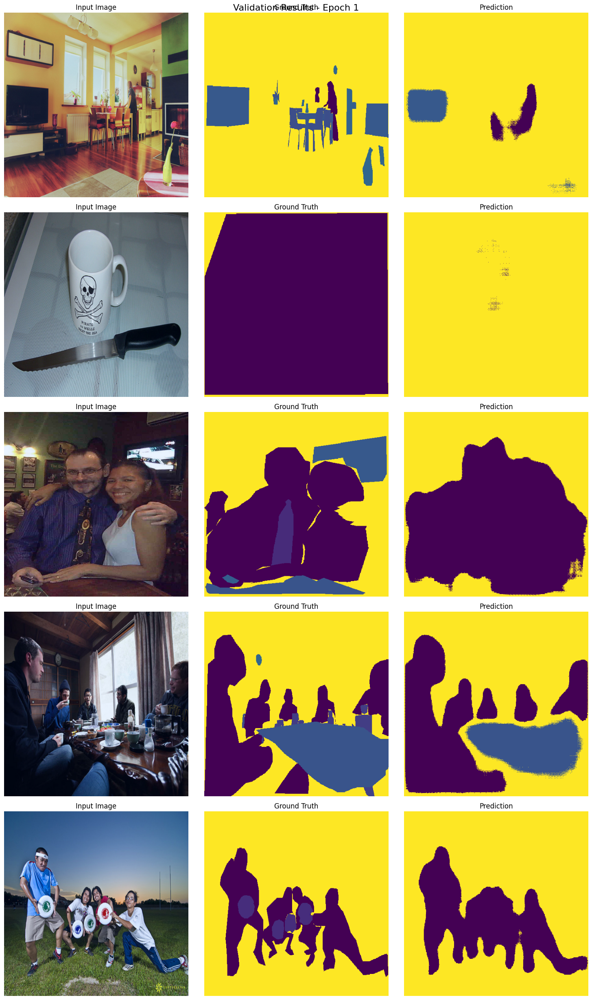

Train - Loss: 0.9378, Pixel Acc: 0.7749, Mean IoU: 0.0517
Val   - Loss: 0.7170, Pixel Acc: 0.8100, Mean IoU: 0.1089

Epoch 2/10


Validation: 100%|██████████| 157/157 [01:14<00:00,  2.12it/s]


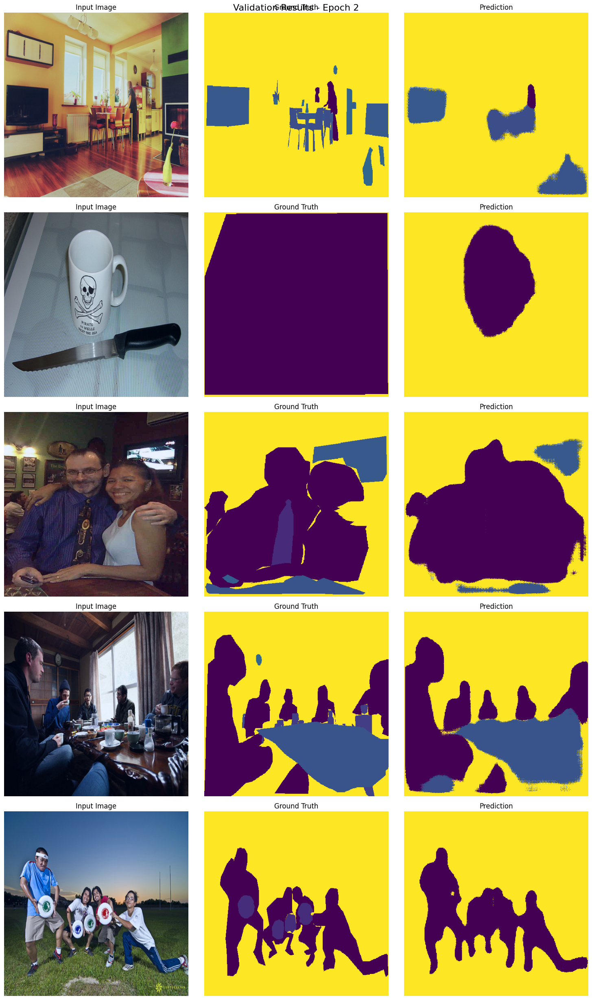

Train - Loss: 0.5717, Pixel Acc: 0.8438, Mean IoU: 0.1978
Val   - Loss: 0.5509, Pixel Acc: 0.8494, Mean IoU: 0.2264

Epoch 3/10


Validation: 100%|██████████| 157/157 [01:03<00:00,  2.48it/s]


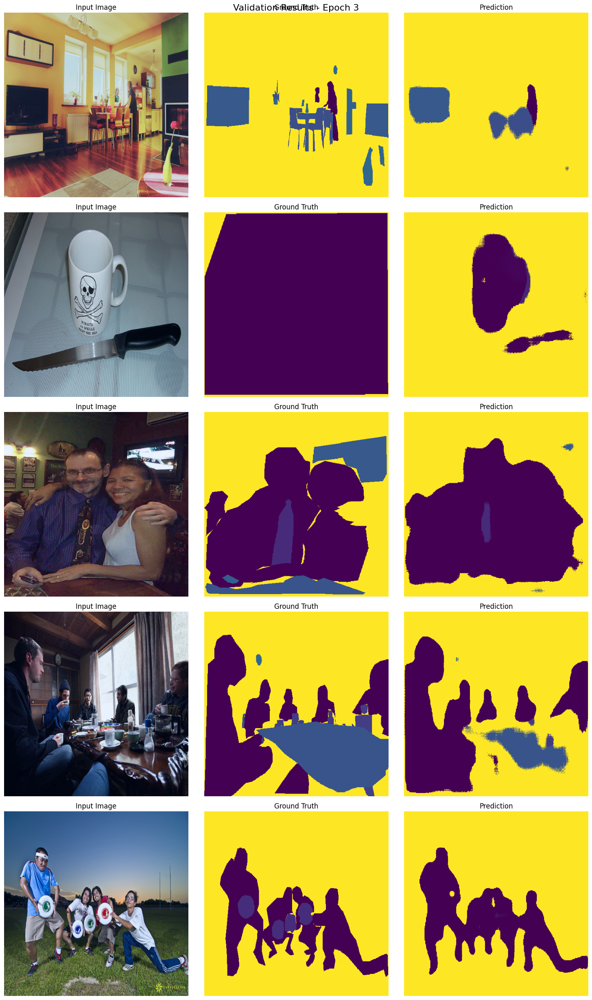

Train - Loss: 0.4666, Pixel Acc: 0.8668, Mean IoU: 0.3093
Val   - Loss: 0.5014, Pixel Acc: 0.8624, Mean IoU: 0.3187

Epoch 4/10


Validation: 100%|██████████| 157/157 [01:09<00:00,  2.27it/s]


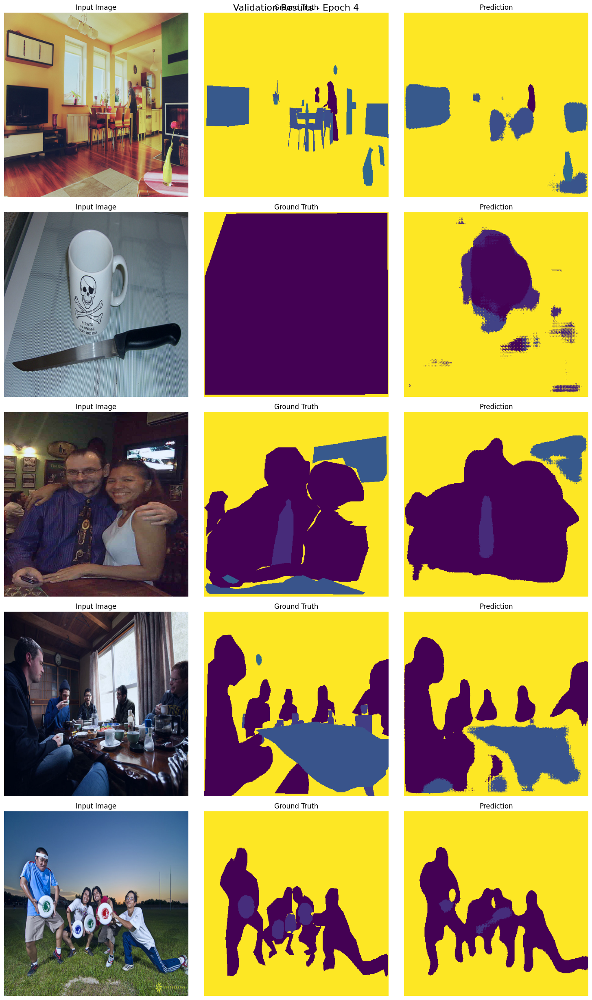

Train - Loss: 0.4119, Pixel Acc: 0.8785, Mean IoU: 0.3732
Val   - Loss: 0.4632, Pixel Acc: 0.8712, Mean IoU: 0.3719

Epoch 5/10


Validation: 100%|██████████| 157/157 [01:08<00:00,  2.30it/s]


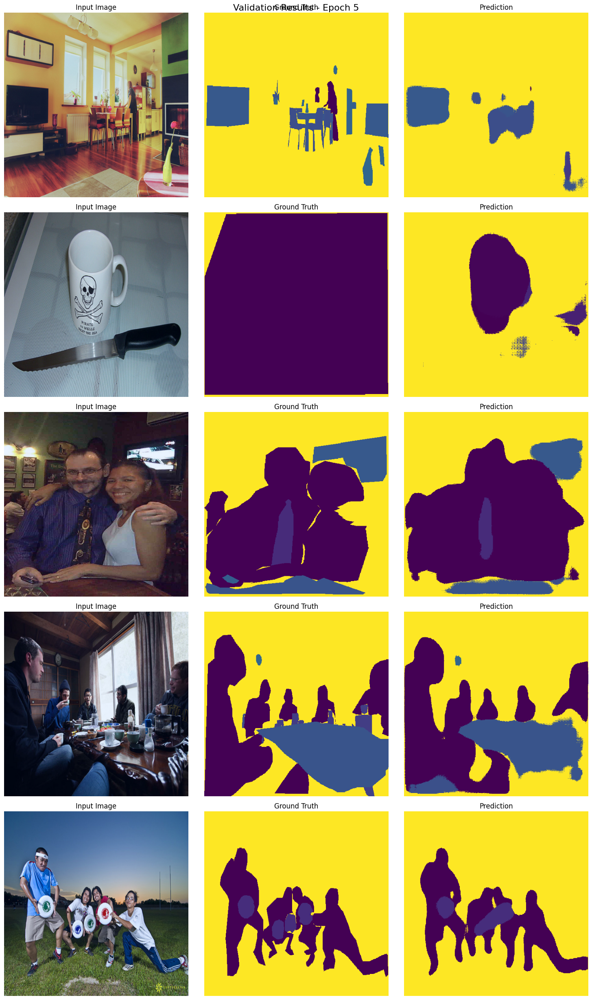

Train - Loss: 0.3723, Pixel Acc: 0.8868, Mean IoU: 0.4130
Val   - Loss: 0.4584, Pixel Acc: 0.8717, Mean IoU: 0.3858

Epoch 6/10


Validation: 100%|██████████| 157/157 [01:08<00:00,  2.29it/s]


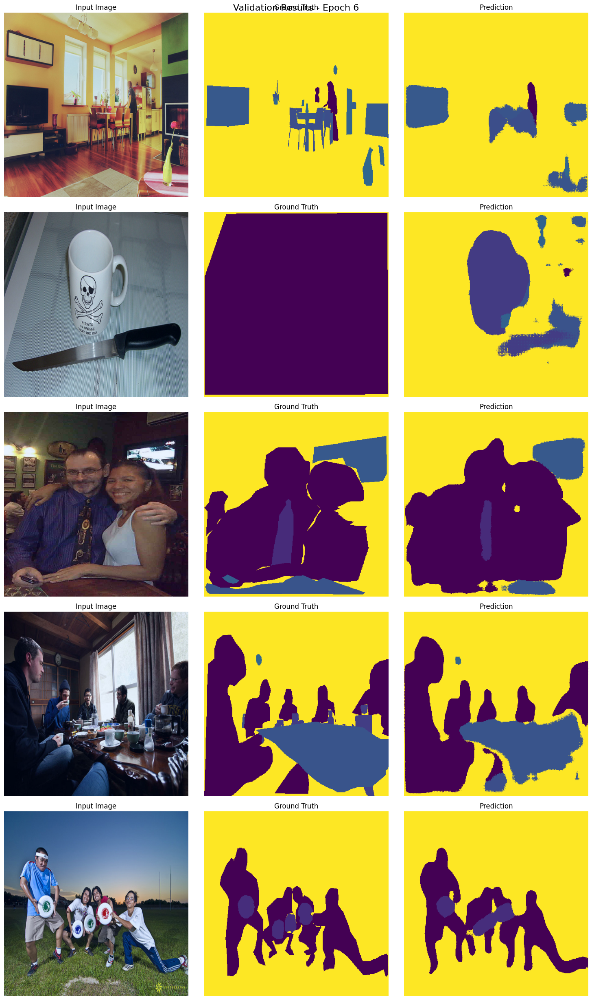

Train - Loss: 0.3410, Pixel Acc: 0.8936, Mean IoU: 0.4418
Val   - Loss: 0.4496, Pixel Acc: 0.8729, Mean IoU: 0.3823

Epoch 7/10


Validation: 100%|██████████| 157/157 [01:10<00:00,  2.23it/s]


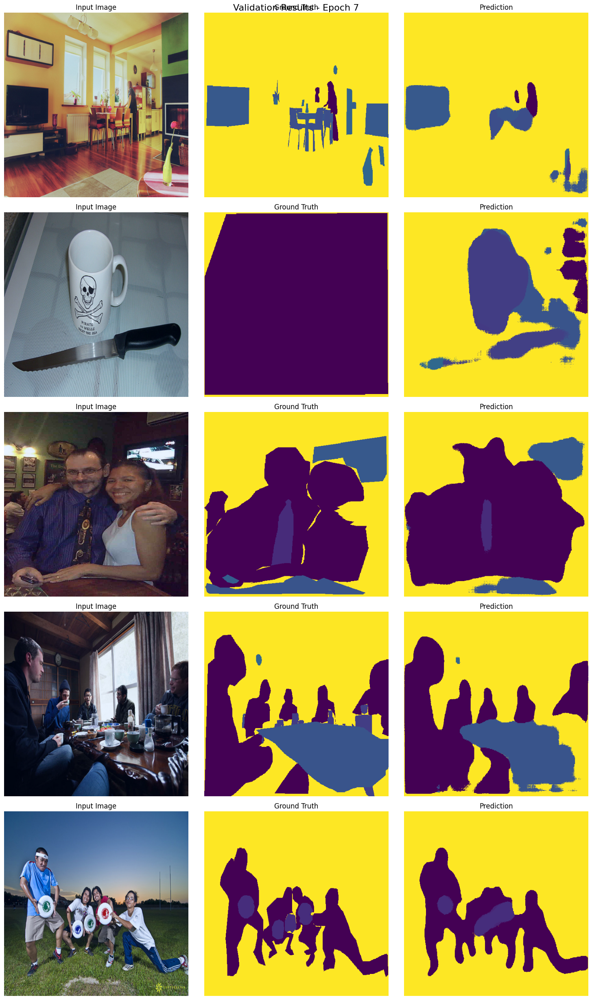

Train - Loss: 0.3147, Pixel Acc: 0.8999, Mean IoU: 0.4683
Val   - Loss: 0.4541, Pixel Acc: 0.8733, Mean IoU: 0.3983

Epoch 8/10


Validation: 100%|██████████| 157/157 [01:02<00:00,  2.52it/s]


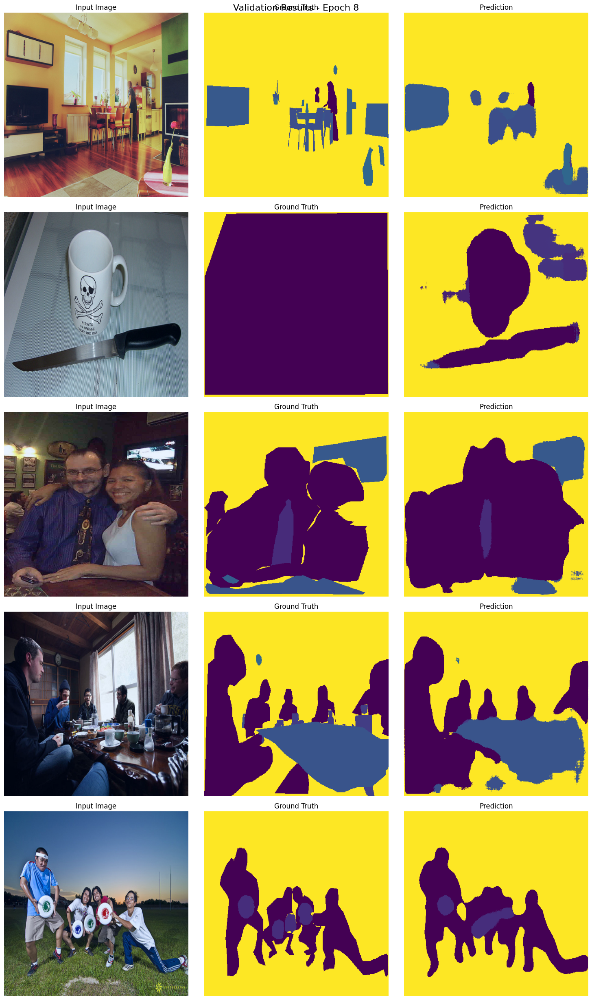

Train - Loss: 0.2922, Pixel Acc: 0.9055, Mean IoU: 0.4928
Val   - Loss: 0.4442, Pixel Acc: 0.8750, Mean IoU: 0.4188

Epoch 9/10


Validation: 100%|██████████| 157/157 [01:09<00:00,  2.26it/s]


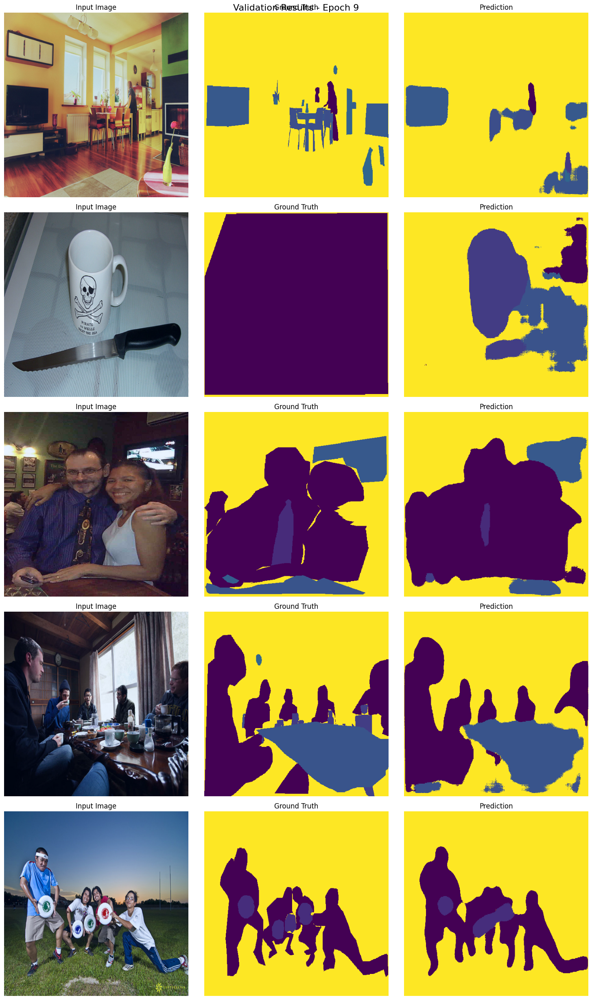

Train - Loss: 0.2728, Pixel Acc: 0.9107, Mean IoU: 0.5120
Val   - Loss: 0.4581, Pixel Acc: 0.8734, Mean IoU: 0.3999

Epoch 10/10


Validation: 100%|██████████| 157/157 [01:08<00:00,  2.28it/s]


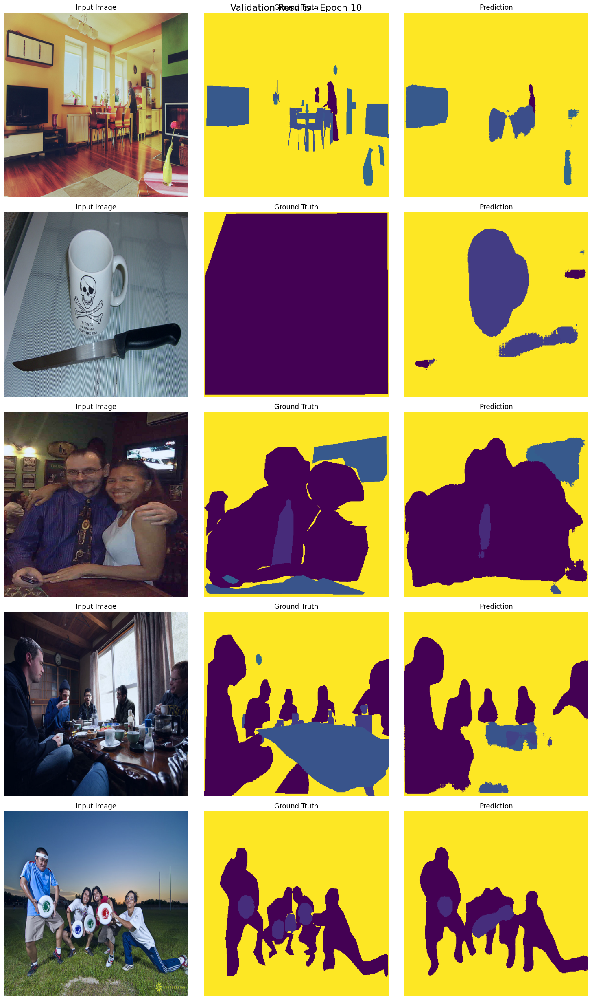

Train - Loss: 0.2553, Pixel Acc: 0.9157, Mean IoU: 0.5286
Val   - Loss: 0.4868, Pixel Acc: 0.8743, Mean IoU: 0.4084


In [6]:
from torch.utils.data import DataLoader
from torch import nn
import torch.optim as optim
from tqdm import tqdm
from torch.amp import autocast, GradScaler
import numpy as np
import itertools
import matplotlib.pyplot as plt
# Create data loaders
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=8)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False, num_workers=8)

class SegmentationHead(nn.Module):
    def __init__(self, in_channels, num_classes):
        super().__init__()
        self.decoder = nn.Sequential(
            # Starting from 16x16 (after encoder)
            nn.ConvTranspose2d(in_channels, 256, kernel_size=4, stride=2, padding=1),  # -> 32x32
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),  # -> 64x64
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),  # -> 128x128
            nn.ReLU(),
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1),  # -> 256x256
            nn.ReLU(),
            nn.ConvTranspose2d(32, num_classes, kernel_size=4, stride=2, padding=1),  # -> 512x512
        )
    
    def forward(self, x):
        return self.decoder(x)

# Initialize models and training components
num_classes = 91  # COCO has 90 classes + background
decoder = SegmentationHead(in_channels=2048, num_classes=num_classes).to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(list(decoder.parameters()) + list(encoder.parameters()), lr=1e-4)
scaler = GradScaler(device=device)

def fast_hist(a: np.ndarray, b: np.ndarray, n: int) -> np.ndarray:
    k = (b >= 0) & (b < n)
    return np.bincount(n * a[k].astype(int) + b[k], minlength=n ** 2).reshape(n, n)

def per_class_iou(hist: np.ndarray) -> np.ndarray:
    epsilon = 1e-5
    return (np.diag(hist)) / (hist.sum(1) + hist.sum(0) - np.diag(hist) + epsilon)

def train_one_epoch(encoder, decoder, dataloader, criterion, optimizer, scaler):
    decoder.train()
    encoder.train()
    total_loss = 0
    hist = np.zeros((num_classes, num_classes))
    total_pixels = 0
    correct_pixels = 0
    
    for images, masks in tqdm(dataloader, desc="Training"):
        images, masks = images.to(device), masks.to(device)
        
        optimizer.zero_grad()
        
        with autocast(device_type = 'cuda'):
            # with torch.no_grad():
            features = encoder(images)['res5']
            
            outputs = decoder(features)
            loss = criterion(outputs, masks)
        
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        
        total_loss += loss.item()
        
        # Calculate metrics
        preds = torch.argmax(outputs, dim=1)
        
        # Pixel Accuracy
        valid_mask = masks != 255
        total_pixels += valid_mask.sum().item()
        correct_pixels += ((preds == masks) & valid_mask).sum().item()
        
        # IoU
        preds = preds.cpu().numpy()
        target = masks.cpu().numpy()
        hist += fast_hist(preds.flatten(), target.flatten(), num_classes)
    
    # Calculate final metrics
    pixel_acc = correct_pixels / total_pixels
    class_acc = np.diag(hist) / (hist.sum(1) + np.finfo(np.float32).eps)
    mean_class_acc = np.nanmean(class_acc)
    iou = per_class_iou(hist)
    mean_iou = np.nanmean(iou)
    
    return {
        'loss': total_loss / len(dataloader),
        'pixel_acc': pixel_acc,
        'mean_class_acc': mean_class_acc,
        'mean_iou': mean_iou,
        'class_iou': iou,
        'class_acc': class_acc
    }

def validate(encoder, decoder, dataloader, criterion):
    decoder.eval()
    encoder.eval()
    total_loss = 0
    hist = np.zeros((num_classes, num_classes))
    total_pixels = 0
    correct_pixels = 0
    
    with torch.no_grad(), autocast(device_type = 'cuda'):
        for images, masks in tqdm(dataloader, desc="Validation"):
            images, masks = images.to(device), masks.to(device)
            
            features = encoder(images)['res5']
            outputs = decoder(features)
            loss = criterion(outputs, masks)
            
            total_loss += loss.item()
            
            preds = torch.argmax(outputs, dim=1)
            
            valid_mask = masks != 255
            total_pixels += valid_mask.sum().item()
            correct_pixels += ((preds == masks) & valid_mask).sum().item()
            
            preds = preds.cpu().numpy()
            target = masks.cpu().numpy()
            hist += fast_hist(preds.flatten(), target.flatten(), num_classes)
    
    pixel_acc = correct_pixels / total_pixels
    class_acc = np.diag(hist) / (hist.sum(1) + np.finfo(np.float32).eps)
    mean_class_acc = np.nanmean(class_acc)
    iou = per_class_iou(hist)
    mean_iou = np.nanmean(iou)
    decoder.eval()
    with torch.no_grad(), autocast(device_type='cuda'):
        # Get 5 random images from validation set
        fig, axes = plt.subplots(5, 3, figsize=(15, 25))
        fig.suptitle(f'Validation Results - Epoch {epoch+1}', fontsize=16)
        
        for i, (images, masks) in enumerate(itertools.islice(val_loader, 5)):
            images, masks = images.to(device), masks.to(device)
            
            # Get predictions
            features = encoder(images)['res5']
            outputs = decoder(features)
            preds = torch.argmax(outputs, dim=1)
            
            # Convert tensors to numpy arrays
            image = images[0].cpu().permute(1,2,0).numpy()
            mask = masks[0].cpu().numpy()
            pred = preds[0].cpu().numpy()
            
            # Normalize image for display
            image = (image - image.min()) / (image.max() - image.min())
            
            # Plot results
            axes[i,0].imshow(image)
            axes[i,0].set_title('Input Image')
            axes[i,0].axis('off')
            mask[mask == 0] = 255
            axes[i,1].imshow(mask, cmap='viridis')
            axes[i,1].set_title('Ground Truth')
            axes[i,1].axis('off')
            pred[pred == 0] = 255
            axes[i,2].imshow(pred, cmap='viridis')
            axes[i,2].set_title('Prediction')
            axes[i,2].axis('off')
        
        plt.tight_layout()
        plt.show()
    return {
        'loss': total_loss / len(dataloader),
        'pixel_acc': pixel_acc,
        'mean_class_acc': mean_class_acc,
        'mean_iou': mean_iou,
        'class_iou': iou,
        'class_acc': class_acc
    }

# Training loop
num_epochs = 10
best_val_miou = 0.0

for epoch in range(num_epochs):
    print(f"\nEpoch {epoch+1}/{num_epochs}")
    
    train_metrics = train_one_epoch(encoder, decoder, train_loader, criterion, optimizer, scaler)
    val_metrics = validate(encoder, decoder, val_loader, criterion)
    
    print(f"Train - Loss: {train_metrics['loss']:.4f}, Pixel Acc: {train_metrics['pixel_acc']:.4f}, "
          f"Mean IoU: {train_metrics['mean_iou']:.4f}")
    print(f"Val   - Loss: {val_metrics['loss']:.4f}, Pixel Acc: {val_metrics['pixel_acc']:.4f}, "
          f"Mean IoU: {val_metrics['mean_iou']:.4f}")
    
    # Save best model based on validation mIoU
    if val_metrics['mean_iou'] > best_val_miou:
        best_val_miou = val_metrics['mean_iou']
        torch.save({
            'decoder_state_dict': decoder.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'epoch': epoch,
            'metrics': val_metrics
        }, 'best_segmentation_model.pth')

In [ ]:
#plot an image with predicted mask & ground truth mask